<a href="https://colab.research.google.com/github/Mamiglia/challenge/blob/master/baseline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# !mkdir data
# !gdown 1CVAQDuPOiwm8h9LJ8a_oOs6zOWS6EgkB
# !gdown 1ykZ9fjTxUwdiEwqagoYZiMcD5aG-7rHe
# !unzip -o test.zip -d data
# !unzip -o train.zip -d data

# !git clone https://github.com/Mamiglia/challenge.git

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset
from pathlib import Path
from tqdm import tqdm
import math
import torch.nn.functional as F 
import numpy as np
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

from src.common import load_data, prepare_train_data, generate_submission

In [3]:
# Configuration
MODEL_PATH = "models/mlp_baseline.pth"
EPOCHS = 20
BATCH_SIZE = 128
LR = 1e-4

DEVICE = torch.device("mps" if torch.mps.is_available() else "cpu")
print(f"Using device: {DEVICE}")

Using device: cpu


In [4]:
class KernelAdapter(nn.Module):
    """Base kernel adapter with Random Fourier Features"""
    def __init__(self, d_in, d_out, n_feats=256, sigma=0.8, dropout=0.1):
        super().__init__()
        self.W = nn.Parameter(torch.randn(d_in, n_feats) / sigma)
        self.b = nn.Parameter(torch.rand(n_feats) * 2 * math.pi)
        self.fc = nn.Linear(n_feats, d_out)
        self.drop = nn.Dropout(dropout)
        self.reset_parameters()

    def reset_parameters(self):
        nn.init.xavier_uniform_(self.fc.weight)
        nn.init.zeros_(self.fc.bias)

    def forward(self, x):
        x_proj = torch.cos(x @ self.W + self.b)
        x_proj = self.drop(x_proj)
        out = self.fc(x_proj)
        return F.normalize(out, dim=-1)


class KernelResidualAdapter(nn.Module):
    """Kernel adapter + residual MLP + local geometric correction"""
    def __init__(self, d_in=1024, d_out=1536, n_feats=512, sigma=0.7):
        super().__init__()
        self.kernel = KernelAdapter(d_in, d_out, n_feats, sigma)
        self.residual = nn.Sequential(
            nn.Linear(d_in, d_out),
            nn.GELU(),
            nn.Linear(d_out, d_out)
        )
        # Local geometric correction (small feature-wise modulation)
        self.local = nn.Sequential(
            nn.Linear(d_in, d_out // 8),
            nn.GELU(),
            nn.Linear(d_out // 8, d_out),
            nn.Tanh()
        )

        # Amplitude scaling gate
        self.scale = nn.Sequential(
            nn.Linear(d_in, d_out),
            nn.Sigmoid()
        )

        # 🔹 Affine alignment layer (Procrustes-like)
        self.align = nn.Linear(d_out, d_out, bias=False)
        nn.init.eye_(self.align.weight)  # inizializza come identità

    def forward(self, x):
        base = self.kernel(x)
        res = self.residual(x)
        local = self.local(x) * 0.3  # local correction term (scaled)
        scale = self.scale(x)

        # composizione finale
        out = (base + 0.5 * res + local) * scale
        out = self.align(out)  # affine rotation layer

        # normalizzazione su sfera unitaria
        # return F.normalize(out, dim=-1)
        return out

In [5]:
def hybrid_loss(z_pred, z_true, temperature=0.15, alpha=0.2, beta=0.6, gamma=1.5, hard_neg_weight=0.1):
    # === Allineamento direzionale ===
    mse = F.mse_loss(z_pred, z_true)
    cos = 1 - F.cosine_similarity(z_pred, z_true, dim=-1).mean()

    # === InfoNCE standard ===
    z_pred = F.normalize(z_pred, dim=-1)
    z_true = F.normalize(z_true, dim=-1)
    logits = (z_pred @ z_true.T) / temperature
    labels = torch.arange(logits.size(0), device=z_pred.device)
    contrast = F.cross_entropy(logits, labels)

    # === Penalizzazione hard negatives (solo nei logits “vicini”) ===
    with torch.no_grad():
        mask_pos = torch.eye(logits.size(0), device=logits.device).bool()
        logits_neg = logits.masked_fill(mask_pos, -1e-9)
        sim_ranks = logits_neg.topk(k=5, dim=1).indices
    hard_mask = torch.zeros_like(logits)
    hard_mask.scatter_(1, sim_ranks, 1.0)
    hard_neg = torch.log1p((hard_mask * torch.exp(logits_neg)).sum(1)).mean()

    return alpha*mse + beta*cos + gamma*contrast + hard_neg_weight * hard_neg

def align_uniform_loss(z1, z2, alpha=2, lam=0.1):
    # Allineamento (positivi)
    align = (z1 - z2).pow(2).sum(1).pow(alpha / 2).mean()

    # Uniformità (negativi)
    z1 = F.normalize(z1, dim=-1)
    sim_matrix = z1 @ z1.T
    sq_dist = 2 - 2 * sim_matrix  # ||x_i - x_j||^2

    # Maschera la diagonale
    n = sq_dist.size(0)
    mask = ~torch.eye(n, device=z1.device, dtype=torch.bool)
    sq_dist_no_diag = sq_dist[mask]

    uniform = torch.log(torch.exp(-lam * sq_dist_no_diag).mean())
    return align + uniform



In [6]:
def metric_reg(z_pred, z_text, k=30):
    with torch.no_grad():
        sims_text = (z_text @ z_text.T)

        # Maschera la diagonale per escludere i self-pairs
        n = sims_text.size(0)
        sims_text = sims_text.masked_fill(torch.eye(n, device=z_text.device).bool(), -1e9)

        # 🔹 Limita k per evitare "selected index out of range"
        k = min(k, n - 1)

        # Trova i top-k simili (escludendo il self)
        idx = sims_text.topk(k, dim=1).indices

        # Crea maschera dei vicini
        mask = torch.zeros_like(sims_text)
        mask.scatter_(1, idx, 1.0)

    sims_pred = (z_pred @ z_pred.T)
    return ((mask * (sims_pred - sims_text))**2).mean()

def relational_alignment_loss(z_pred, S_target, batch_idx):
    """
    Align predicted relational structure (cosine-based) to target geodesic structure.
    Scales cosine [-1,1] → [0,1] to match Gaussian kernel range.
    """
    N = z_pred.shape[0]
    idx_cpu = batch_idx.cpu()
    max_idx = S_target.size(0)

    # Usa solo indici che esistono in S_target
    valid_idx = idx_cpu[idx_cpu < max_idx]
    if len(valid_idx) < 2:
        return torch.tensor(0.0, device=z_pred.device)

    S_sub = S_target[valid_idx][:, valid_idx].to(z_pred.device)

    # Predicted relational structure (cosine-based)
    z_sub = F.normalize(z_pred[:len(valid_idx)], dim=-1)
    S_pred = z_sub @ z_sub.T

    # 🔹 Scale match: map [-1, 1] → [0, 1]
    S_pred = (S_pred + 1) / 2

    # Exclude diagonal
    mask = ~torch.eye(len(valid_idx), device=z_pred.device, dtype=torch.bool)

    loss = F.mse_loss(S_pred[mask], S_sub[mask])
    return loss


In [7]:
def compute_geodesic_similarity(Y, scale=0.5, max_points=2000):
    if len(Y) > max_points:
        idx = torch.randperm(len(Y))[:max_points]
        Y = Y[idx]
    else:
        idx = torch.arange(len(Y))

    dist2 = torch.cdist(Y, Y, p=2).pow(2)
    mean_d2 = dist2.mean().item()
    sigma = (mean_d2 ** 0.5) * scale
    print(f"[auto-sigma] mean distance²={mean_d2:.4f}, sigma={sigma:.4f}")

    S = torch.exp(-dist2 / (2 * sigma**2))
    S = S / S.max()
    return S, idx


In [8]:
def compute_text_similarity(X, max_points=2000):
    if len(X) > max_points:
        idx = torch.randperm(len(X))[:max_points]
        X = X[idx]
    S = (F.cosine_similarity(X.unsqueeze(1), X.unsqueeze(0), dim=-1) + 1) / 2
    return S

In [9]:
def parallel_transport_loss(z_pred, z_text):
    if z_text.size(0) < 2:
        return torch.tensor(0.0, device=z_pred.device)
    dz = z_text[1:] - z_text[:-1]
    dp = z_pred[1:] - z_pred[:-1]
    dz = F.normalize(dz, dim=-1)
    dp = F.normalize(dp, dim=-1)
    # riduci alla dimensione minima comune
    d = min(dz.shape[-1], dp.shape[-1])
    dz, dp = dz[..., :d], dp[..., :d]
    return 1 - F.cosine_similarity(dp, dz, dim=-1).mean()


In [10]:
def train_model(model, train_loader, val_loader, device, epochs, lr, S_vae):
    optimizer = optim.Adam(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.OneCycleLR(
        optimizer,
        max_lr=5e-4,
        epochs=epochs,
        steps_per_epoch=len(train_loader)
    )

    best_val_loss = float('inf')

    for epoch in range(epochs):
        model.train()
        train_loss = 0.0

        for X_batch, y_batch, idx_batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs}"):
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            optimizer.zero_grad()

            outputs = model(X_batch)

            loss = (
                hybrid_loss(outputs, y_batch)
                + 0.2 * metric_reg(outputs, y_batch)
                + 0.1 * align_uniform_loss(outputs, y_batch)
                + 0.3 * relational_alignment_loss(outputs, S_vae, idx_batch)
                + 0.05 * parallel_transport_loss(outputs, X_batch)
            )

            loss.backward()
            optimizer.step()
            scheduler.step()
            train_loss += loss.item()

        train_loss /= len(train_loader)

        # === VALIDATION ===
        model.eval()
        val_loss, cos_sim, mse, contrastive = 0, 0, 0, 0

        with torch.no_grad():
            for X_batch, y_batch, idx_batch in val_loader:  # ✅ aggiornata qui
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)
                outputs = model(X_batch)
                loss = (
                    hybrid_loss(outputs, y_batch)
                    + 0.2 * metric_reg(outputs, y_batch)
                    + 0.1 * align_uniform_loss(outputs, y_batch)
                    + 0.3 * relational_alignment_loss(outputs, S_vae, idx_batch)
                    + 0.05 * parallel_transport_loss(outputs, X_batch)
                )
                val_loss += loss.item()
                cos_sim += F.cosine_similarity(outputs, y_batch, dim=-1).mean().item()
                mse += F.mse_loss(outputs, y_batch).item()
                sim = (F.normalize(outputs, dim=-1) @ F.normalize(y_batch, dim=-1).T)
                pos = torch.arange(sim.size(0), device=device)
                contrastive += F.cross_entropy(sim / 0.07, pos).item()

        n_batches = len(val_loader)
        val_loss /= n_batches
        cos_sim /= n_batches
        mse /= n_batches
        contrastive /= n_batches

        print(f"Cosine={cos_sim:.4f}, MSE={mse:.4f}, Contrastive={contrastive:.4f}")
        print(f"Epoch {epoch+1}: TrainLoss={train_loss:.4f}, ValLoss={val_loss:.4f}")

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            Path(MODEL_PATH).parent.mkdir(parents=True, exist_ok=True)
            torch.save(model.state_dict(), MODEL_PATH)
            print(f"  ✓ Saved best model (val_loss={val_loss:.6f})")

    return model


In [11]:
def whiten(X, eps=1e-6):
    X = X - X.mean(0, keepdim=True)
    cov = (X.T @ X) / (X.shape[0] - 1)
    eigvals, eigvecs = torch.linalg.eigh(cov)
    
    # Evita divisione per 0
    eigvals = torch.clamp(eigvals, min=eps)
    
    W = eigvecs @ torch.diag(1.0 / torch.sqrt(eigvals)) @ eigvecs.T
    return X @ W

# SVD VERSION 
# def whiten(X, eps=1e-6):
#     """
#     Whiten data matrix X using SVD decomposition (numerically stable).

#     Args:
#         X (torch.Tensor): input data of shape [N, D]
#         eps (float): small constant for numerical stability
#     Returns:
#         torch.Tensor: whitened data of shape [N, D]
#     """
#     # 1️⃣ Center the data (remove mean)
#     X = X - X.mean(0, keepdim=True)
    
#     # 2️⃣ Compute SVD (does not require explicit covariance)
#     # X = U * S * Vh, where columns of Vh are principal directions
#     U, S, Vh = torch.linalg.svd(X, full_matrices=False)
    
#     # 3️⃣ Scale by inverse sqrt of singular values
#     # (equivalent to dividing by std in each PCA direction)
#     X_white = (U @ torch.diag(1.0 / torch.sqrt(S + eps))) @ Vh
    
#     # 4️⃣ Optional: normalize each vector to unit norm
#     X_white = F.normalize(X_white, dim=-1)
    
#     return X_white

(125000,)
Train data: 125000 captions, 125000 images
[auto-sigma] mean distance²=592.7370, sigma=12.1731
Computed S_vae with shape: torch.Size([2000, 2000])


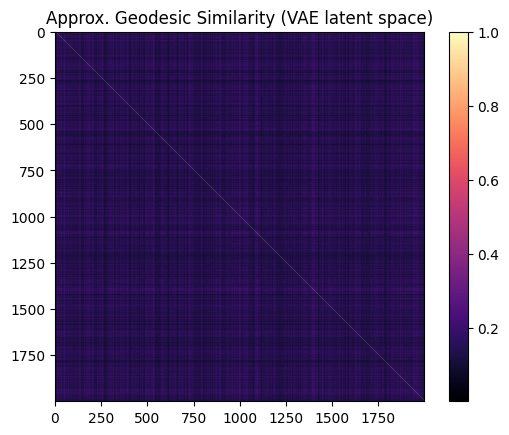

Computed S_text with shape: torch.Size([512, 512])


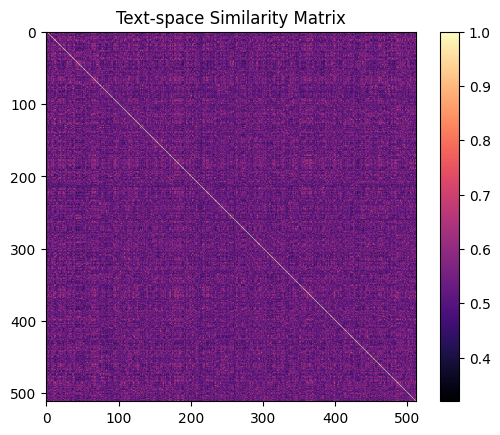

In [12]:
# Load data
train_data = load_data("data/train/train.npz")
X, y, label = prepare_train_data(train_data)

S_vae, idx_vae = compute_geodesic_similarity(y, scale=0.5)
print("Computed S_vae with shape:", S_vae.shape)
plt.imshow(S_vae.cpu().numpy(), cmap='magma')
plt.title("Approx. Geodesic Similarity (VAE latent space)")
plt.colorbar()
plt.show()

# X = whiten(X)
# y = whiten(y)
X = F.normalize(X, dim=-1)
y = F.normalize(y, dim=-1)


# === Approximate Similarity in the Text Embedding Space ===
S_text = compute_text_similarity(X, 512)
print("Computed S_text with shape:", S_text.shape)
plt.imshow(S_text.cpu().numpy(), cmap='magma')
plt.title("Text-space Similarity Matrix")
plt.colorbar()
plt.show()

DATASET_SIZE = len(X)
# Split train/val
# This is done only to measure generalization capabilities, you don't have to
# use a validation set (though we encourage this)
n_train = int(0.9 * len(X))
TRAIN_SPLIT = torch.zeros(len(X), dtype=torch.bool)
TRAIN_SPLIT[:n_train] = 1
X_train, X_val = X[TRAIN_SPLIT], X[~TRAIN_SPLIT]
y_train, y_val = y[TRAIN_SPLIT], y[~TRAIN_SPLIT]


train_dataset = TensorDataset(X_train, y_train, torch.arange(len(X_train)))
val_dataset = TensorDataset(X_val, y_val, torch.arange(len(X_val)))

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)

In [13]:
model = KernelResidualAdapter().to(DEVICE)
print(f"   Parameters: {sum(p.numel() for p in model.parameters()):,}")

# Train
print("\n3. Training...")
model = train_model(model, train_loader, val_loader, DEVICE, EPOCHS, LR, S_vae)

# Load best model for evaluation
model.load_state_dict(torch.load(MODEL_PATH))

   Parameters: 9,674,944

3. Training...


Epoch 1/20: 100%|██████████| 879/879 [00:37<00:00, 23.72it/s]


Cosine=0.4469, MSE=0.0006, Contrastive=2.8176
Epoch 1: TrainLoss=6.8113, ValLoss=6.2618
  ✓ Saved best model (val_loss=6.261839)


Epoch 2/20: 100%|██████████| 879/879 [00:36<00:00, 23.79it/s]


Cosine=0.4528, MSE=0.0005, Contrastive=2.5512
Epoch 2: TrainLoss=5.8717, ValLoss=5.9431
  ✓ Saved best model (val_loss=5.943053)


Epoch 3/20: 100%|██████████| 879/879 [00:36<00:00, 23.76it/s]


Cosine=0.4518, MSE=0.0005, Contrastive=2.4718
Epoch 3: TrainLoss=5.6094, ValLoss=5.8456
  ✓ Saved best model (val_loss=5.845555)


Epoch 4/20: 100%|██████████| 879/879 [00:36<00:00, 24.40it/s]


Cosine=0.4603, MSE=0.0006, Contrastive=2.4430
Epoch 4: TrainLoss=5.5023, ValLoss=5.8023
  ✓ Saved best model (val_loss=5.802344)


Epoch 5/20: 100%|██████████| 879/879 [00:35<00:00, 24.76it/s]


Cosine=0.4692, MSE=0.0006, Contrastive=2.4210
Epoch 5: TrainLoss=5.4337, ValLoss=5.7665
  ✓ Saved best model (val_loss=5.766532)


Epoch 6/20: 100%|██████████| 879/879 [00:36<00:00, 24.39it/s]


Cosine=0.4670, MSE=0.0006, Contrastive=2.3883
Epoch 6: TrainLoss=5.3579, ValLoss=5.7164
  ✓ Saved best model (val_loss=5.716403)


Epoch 7/20: 100%|██████████| 879/879 [00:35<00:00, 24.67it/s]


Cosine=0.4698, MSE=0.0006, Contrastive=2.3734
Epoch 7: TrainLoss=5.2743, ValLoss=5.6884
  ✓ Saved best model (val_loss=5.688437)


Epoch 8/20: 100%|██████████| 879/879 [00:35<00:00, 24.78it/s]


Cosine=0.4611, MSE=0.0006, Contrastive=2.3460
Epoch 8: TrainLoss=5.1983, ValLoss=5.6509
  ✓ Saved best model (val_loss=5.650852)


Epoch 9/20: 100%|██████████| 879/879 [00:35<00:00, 24.88it/s]


Cosine=0.4668, MSE=0.0006, Contrastive=2.3383
Epoch 9: TrainLoss=5.1239, ValLoss=5.6327
  ✓ Saved best model (val_loss=5.632670)


Epoch 10/20: 100%|██████████| 879/879 [00:36<00:00, 24.29it/s]


Cosine=0.4680, MSE=0.0006, Contrastive=2.3217
Epoch 10: TrainLoss=5.0582, ValLoss=5.6147
  ✓ Saved best model (val_loss=5.614683)


Epoch 11/20: 100%|██████████| 879/879 [00:35<00:00, 24.48it/s]


Cosine=0.4678, MSE=0.0005, Contrastive=2.3158
Epoch 11: TrainLoss=4.9999, ValLoss=5.6019
  ✓ Saved best model (val_loss=5.601942)


Epoch 12/20: 100%|██████████| 879/879 [00:35<00:00, 24.57it/s]


Cosine=0.4665, MSE=0.0005, Contrastive=2.3101
Epoch 12: TrainLoss=4.9409, ValLoss=5.5941
  ✓ Saved best model (val_loss=5.594071)


Epoch 13/20: 100%|██████████| 879/879 [00:35<00:00, 24.66it/s]


Cosine=0.4621, MSE=0.0005, Contrastive=2.3052
Epoch 13: TrainLoss=4.8869, ValLoss=5.5931
  ✓ Saved best model (val_loss=5.593076)


Epoch 14/20: 100%|██████████| 879/879 [00:35<00:00, 24.88it/s]


Cosine=0.4592, MSE=0.0005, Contrastive=2.3066
Epoch 14: TrainLoss=4.8360, ValLoss=5.5891
  ✓ Saved best model (val_loss=5.589068)


Epoch 15/20: 100%|██████████| 879/879 [00:35<00:00, 24.77it/s]


Cosine=0.4580, MSE=0.0005, Contrastive=2.3066
Epoch 15: TrainLoss=4.7894, ValLoss=5.5909


Epoch 16/20: 100%|██████████| 879/879 [00:35<00:00, 24.66it/s]


Cosine=0.4542, MSE=0.0005, Contrastive=2.3077
Epoch 16: TrainLoss=4.7493, ValLoss=5.5896


Epoch 17/20: 100%|██████████| 879/879 [00:35<00:00, 24.71it/s]


Cosine=0.4518, MSE=0.0005, Contrastive=2.3079
Epoch 17: TrainLoss=4.7109, ValLoss=5.5896


Epoch 18/20: 100%|██████████| 879/879 [00:35<00:00, 24.85it/s]


Cosine=0.4522, MSE=0.0005, Contrastive=2.3075
Epoch 18: TrainLoss=4.6872, ValLoss=5.5934


Epoch 19/20: 100%|██████████| 879/879 [00:35<00:00, 24.89it/s]


Cosine=0.4513, MSE=0.0005, Contrastive=2.3077
Epoch 19: TrainLoss=4.6687, ValLoss=5.5952


Epoch 20/20: 100%|██████████| 879/879 [00:36<00:00, 24.37it/s]


Cosine=0.4499, MSE=0.0005, Contrastive=2.3083
Epoch 20: TrainLoss=4.6605, ValLoss=5.5955


<All keys matched successfully>

## Evaluation

### Visualize

In [17]:
def visualize_latent_space(model, X_val, y_val, device, method="pca", n_samples=2000):
    model.eval()
    with torch.no_grad():
        X_val = X_val[:n_samples].to(device)
        y_val = y_val[:n_samples].to(device)
        z_pred = model(X_val).cpu()
        z_true = y_val.cpu()

    if method == "tsne":
        reducer = TSNE(n_components=2, perplexity=30, n_iter=1000, init="pca")
    else:
        reducer = PCA(n_components=2)

    z_pred_2d = reducer.fit_transform(z_pred)
    z_true_2d = reducer.fit_transform(z_true)

    plt.figure(figsize=(8, 6))
    plt.scatter(z_true_2d[:, 0], z_true_2d[:, 1], alpha=0.5, s=12, label="True (Target Space)")
    plt.scatter(z_pred_2d[:, 0], z_pred_2d[:, 1], alpha=0.5, s=12, label="Predicted (Mapped Space)")
    plt.title(f"Latent Space Visualization ({method.upper()})")
    plt.legend()
    plt.show()


import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt

def make_tsne(n_components=2, perplexity=30, seed=42, n_iter=1000, init="pca"):
    # Prova varie firme di scikit-learn senza dipendenze extra
    from sklearn.manifold import TSNE
    base = dict(n_components=n_components, perplexity=perplexity, init=init, random_state=seed)
    for kw in (
        dict(learning_rate="auto", n_iter=n_iter),
        dict(learning_rate="auto"),
        dict(learning_rate=200.0, n_iter=n_iter),
        dict(learning_rate=200.0, max_iter=n_iter),
        dict(learning_rate=200.0),
    ):
        try:
            return TSNE(**base, **kw)
        except TypeError:
            continue
    return TSNE(**base)

@torch.no_grad()
def visualize_tsne(model, X_val, y_val, device, n_samples=2000, perplexity=30, seed=42):
    model.eval()
    Xb = X_val[:n_samples].to(device)
    Yb = y_val[:n_samples].to(device)

    Z_pred = F.normalize(model(Xb), dim=-1).cpu().numpy()
    Z_true = F.normalize(Yb, dim=-1).cpu().numpy()

    # Fit t-SNE su dati concatenati → assi coerenti
    Z_all = np.concatenate([Z_true, Z_pred], axis=0)
    tsne = make_tsne(n_components=2, perplexity=perplexity, seed=seed, n_iter=1000, init="pca")
    Z2 = tsne.fit_transform(Z_all)

    n = len(Z_true)
    Z_true2, Z_pred2 = Z2[:n], Z2[n:]

    plt.figure(figsize=(7,6))
    plt.scatter(Z_true2[:,0], Z_true2[:,1], s=6, alpha=0.6, label="True")
    plt.scatter(Z_pred2[:,0], Z_pred2[:,1], s=6, alpha=0.6, label="Pred")
    plt.title("t-SNE (assi condivisi)")
    plt.legend()
    plt.tight_layout()
    plt.show()



In [23]:
# ✅ Drop-in override per 3D (compat + assi condivisi)
import numpy as np
import torch
import torch.nn.functional as F
from sklearn.decomposition import PCA

# Helper TSNE compatibile con varie versioni di scikit-learn
def make_tsne(n_components=2, perplexity=30, seed=42, n_iter=1000, init="pca"):
    from sklearn.manifold import TSNE
    base = dict(n_components=n_components, perplexity=perplexity, init=init, random_state=seed)
    for kw in (
        dict(learning_rate="auto", n_iter=n_iter),
        dict(learning_rate="auto"),
        dict(learning_rate=200.0, n_iter=n_iter),
        dict(learning_rate=200.0, max_iter=n_iter),
        dict(learning_rate=200.0),
    ):
        try:
            return TSNE(**base, **kw)
        except TypeError:
            continue
    return TSNE(**base)

# Wrapper visualizzazione robusto (usa Plotly se disponibile, altrimenti Matplotlib 3D)
try:
    import plotly.graph_objects as go
    _HAS_PLOTLY = True
except Exception:
    _HAS_PLOTLY = False
import matplotlib.pyplot as plt

def _show_plotly(fig):
    try:
        import plotly.io as pio
        for r in ["notebook_connected", "vscode", "colab", "iframe_connected", "jupyterlab", "notebook", "browser"]:
            try:
                pio.renderers.default = r
                fig.show(renderer=r)
                return
            except Exception:
                continue
        # Fallback salvataggio HTML
        fig.write_html("latent3d.html", include_plotlyjs="cdn")
        print("[Plotly] Inline non disponibile: salvato in latent3d.html")
    except Exception as e:
        fig.write_html("latent3d.html", include_plotlyjs="cdn")
        print(f"[Plotly] Errore ({e}). Salvato in latent3d.html")

@torch.no_grad()
def visualize_latent_space_3d(model, X_val, y_val, device, n_samples=2000, method="pca",
                              perplexity=30, seed=42):
    model.eval()
    Xb = X_val[:n_samples].to(device)
    Yb = y_val[:n_samples].to(device)

    Z_pred = F.normalize(model(Xb), dim=-1).cpu().numpy()
    Z_true = F.normalize(Yb, dim=-1).cpu().numpy()

    # Fit riduzione su dati concatenati per avere assi coerenti
    Z_all = np.concatenate([Z_true, Z_pred], axis=0)

    if method.lower() == "tsne":
        tsne3 = make_tsne(n_components=3, perplexity=perplexity, seed=seed, n_iter=1000, init="pca")
        Z3 = tsne3.fit_transform(Z_all)
    else:
        pca3 = PCA(n_components=3)
        Z3 = pca3.fit_transform(Z_all)

    n = len(Z_true)
    Z_true3 = Z3[:n]
    Z_pred3 = Z3[n:]

    if _HAS_PLOTLY:
        fig = go.Figure()
        fig.add_trace(go.Scatter3d(x=Z_true3[:,0], y=Z_true3[:,1], z=Z_true3[:,2],
                                   mode='markers', marker=dict(size=3, opacity=0.6),
                                   name='True (Target Space)'))
        fig.add_trace(go.Scatter3d(x=Z_pred3[:,0], y=Z_pred3[:,1], z=Z_pred3[:,2],
                                   mode='markers', marker=dict(size=3, opacity=0.6),
                                   name='Predicted (Mapped Space)'))
        fig.update_layout(title=f"3D Latent Space ({method.upper()})",
                          scene=dict(xaxis_title='C1', yaxis_title='C2', zaxis_title='C3'),
                          width=850, height=700, legend=dict(x=0.02, y=0.98))
        _show_plotly(fig)
    else:
        # Fallback Matplotlib 3D
        from mpl_toolkits.mplot3d import Axes3D  # noqa: F401
        fig = plt.figure(figsize=(8,6))
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(Z_true3[:,0], Z_true3[:,1], Z_true3[:,2], s=6, alpha=0.6, label="True")
        ax.scatter(Z_pred3[:,0], Z_pred3[:,1], Z_pred3[:,2], s=6, alpha=0.6, label="Pred")
        ax.set_title(f"3D Latent Space ({method.upper()})")
        ax.set_xlabel("C1"); ax.set_ylabel("C2"); ax.set_zlabel("C3")
        ax.legend(); plt.tight_layout(); plt.show()


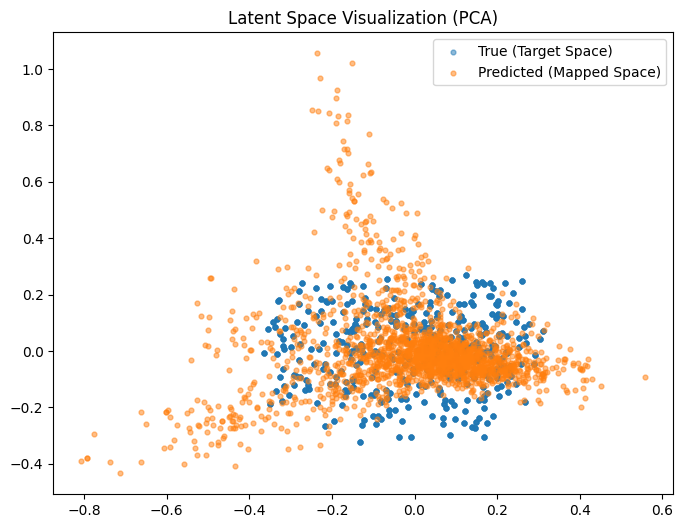

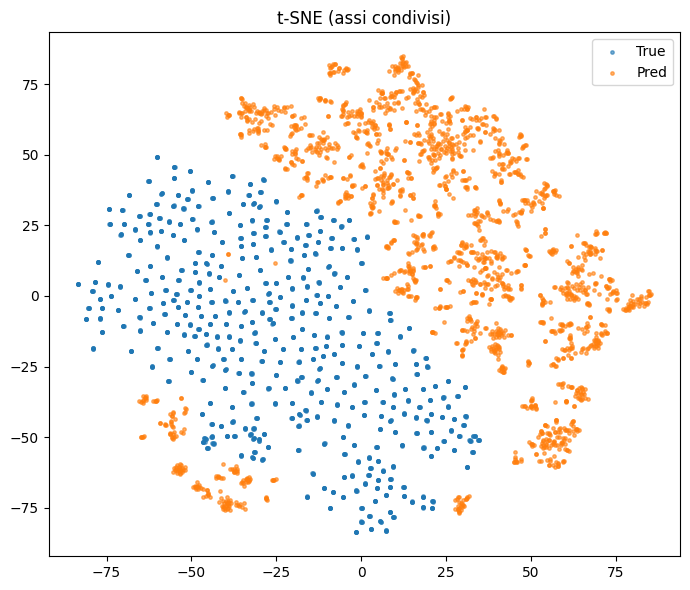

c:\Users\Utente\Documents\GitHub\Challenge-AML\challenge\src\eval\visualize.py:27: UserWarning:

The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\TensorShape.cpp:4419.)



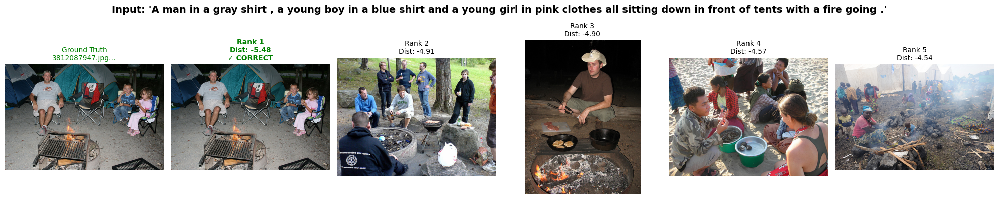

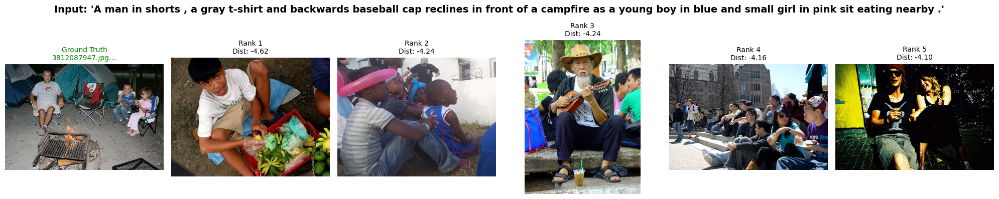

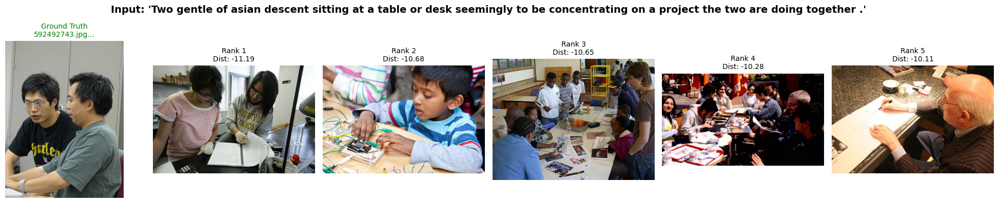

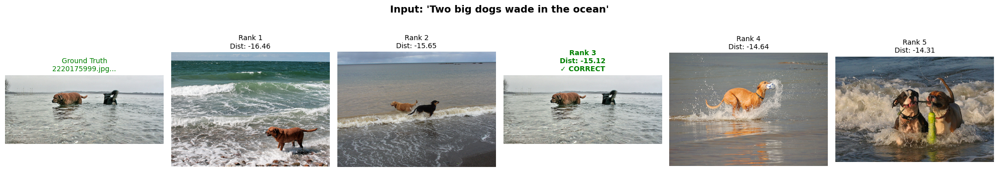

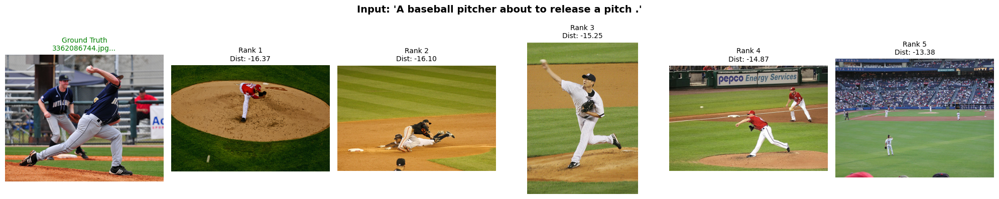

In [24]:
from challenge.src.eval import visualize_retrieval
import numpy as np
import torch

visualize_latent_space(model, X_val, y_val, DEVICE, method="pca")
visualize_tsne(model, X_val, y_val, DEVICE, n_samples=2000)


visualize_latent_space_3d(model, X_val, y_val, DEVICE, n_samples=2000, method="pca")
visualize_latent_space_3d(model, X_val, y_val, DEVICE, n_samples=1000, method="tsne")

val_caption_text = train_data['captions/text'][~TRAIN_SPLIT]
val_text_embd = X_val
img_VAL_SPLIT = label[~TRAIN_SPLIT].sum(dim=0) > 0
val_img_file = train_data['images/names'][img_VAL_SPLIT]
val_img_embd = torch.from_numpy(train_data['images/embeddings'][img_VAL_SPLIT])
val_label = np.nonzero(train_data['captions/label'][~TRAIN_SPLIT][:,img_VAL_SPLIT])[1]

# Sample and visualize
for i in range(5):
    idx = np.random.randint(0, 100)
    caption_embd = val_text_embd[idx]
    caption_text = val_caption_text[idx]
    gt_index = val_label[idx]

    with torch.no_grad():
        pred_embds = model(caption_embd.to(DEVICE)).cpu()

        visualize_retrieval(
            pred_embds,
            gt_index,
            val_img_file,
            caption_text, val_img_embd, k=5)

## Submission

In [25]:
test_data = load_data("data/test/test.clean.npz")

test_embds = test_data['captions/embeddings']
test_embds = torch.from_numpy(test_embds).float()

with torch.no_grad():
    pred_embds = model(test_embds.to(DEVICE)).cpu()

submission = generate_submission(test_data['captions/ids'], pred_embds, 'submission.csv')
print(f"Model saved to: {MODEL_PATH}")

Generating submission file...
✓ Saved submission to submission.csv
Model saved to: models/mlp_baseline.pth


In [26]:
# --- Evaluate retrieval performance ---
from challenge.src.eval import evaluate_retrieval  # adattalo al tuo path
import numpy as np

model.eval()
with torch.no_grad():
    z_pred_val = model(X_val.to(DEVICE)).cpu()

# ground truth embeddings (target images)
z_img_val = y_val.cpu()
gt_indices = np.arange(len(z_img_val))  # ogni caption ha la sua immagine target

results = evaluate_retrieval(
    translated_embd=z_pred_val,
    image_embd=z_img_val,
    gt_indices=gt_indices,
    max_indices=50,
    batch_size=128
)

print("\n=== Retrieval evaluation (validation set) ===")
for k, v in results.items():
    print(f"{k:>12}: {v:.4f}")



=== Retrieval evaluation (validation set) ===
         mrr: 0.4034
        ndcg: 0.5433
 recall_at_1: 0.1711
 recall_at_3: 0.5148
 recall_at_5: 0.8383
recall_at_10: 0.9363
recall_at_50: 0.9961
     l2_dist: 0.9043


## 🔧 Patches: t-SNE compatibile, Visualizzazione 3D coerente, Retrieval robusto

Queste celle sostituiscono/estendono le funzioni di visualizzazione e il blocco di
*visualize_retrieval* per evitare errori di compatibilità (`TSNE(n_iter)`) e garantire
assi condivisi tra True/Pred. Inoltre calcolano in modo robusto l'indice GT per ciascuna caption.

In [27]:

# -- Helper t-SNE compatibile con diverse versioni di scikit-learn --
def make_tsne(n_components=2, perplexity=30, seed=42, n_iter=1000, init="pca"):
    from sklearn.manifold import TSNE
    base = dict(n_components=n_components, perplexity=perplexity, init=init, random_state=seed)
    # Prova con learning_rate='auto' e n_iter
    try:
        return TSNE(learning_rate="auto", n_iter=n_iter, **base)
    except TypeError:
        pass
    # Prova senza n_iter (usa default interno)
    try:
        return TSNE(learning_rate="auto", **base)
    except TypeError:
        pass
    # Prova con learning_rate numerico + n_iter
    try:
        return TSNE(learning_rate=200.0, n_iter=n_iter, **base)
    except TypeError:
        pass
    # Estremo: alcune build usano 'max_iter'
    return TSNE(learning_rate=200.0, max_iter=n_iter, **base)

In [28]:

# -- Visualizzazione 3D con assi condivisi (fit su dati concatenati) --
import numpy as np
import torch
import torch.nn.functional as F
try:
    import plotly.graph_objects as go
except Exception as _e:
    go = None

from sklearn.decomposition import PCA

@torch.no_grad()
def visualize_latent_space_3d(model, X_val, y_val, device, n_samples=2000, method="pca",
                              perplexity=30, seed=42):
    if go is None:
        raise ImportError("Plotly non disponibile. Installa 'plotly' o usa versione Matplotlib.")
    model.eval()
    Xb = X_val[:n_samples].to(device)
    Yb = y_val[:n_samples].to(device)

    Z_pred = F.normalize(model(Xb), dim=-1).cpu().numpy()
    Z_true = F.normalize(Yb, dim=-1).cpu().numpy()

    Z_all = np.concatenate([Z_true, Z_pred], axis=0)

    if method.lower() == "tsne":
        tsne3 = make_tsne(n_components=3, perplexity=perplexity, seed=seed, n_iter=1000, init="pca")
        Z3 = tsne3.fit_transform(Z_all)
    else:
        pca3 = PCA(n_components=3)
        Z3 = pca3.fit_transform(Z_all)

    n = len(Z_true)
    Z_true3 = Z3[:n]
    Z_pred3 = Z3[n:]

    fig = go.Figure()
    fig.add_trace(go.Scatter3d(x=Z_true3[:,0], y=Z_true3[:,1], z=Z_true3[:,2],
                               mode='markers', marker=dict(size=3, opacity=0.6),
                               name='True (Target Space)'))
    fig.add_trace(go.Scatter3d(x=Z_pred3[:,0], y=Z_pred3[:,1], z=Z_pred3[:,2],
                               mode='markers', marker=dict(size=3, opacity=0.6),
                               name='Predicted (Mapped Space)'))
    fig.update_layout(title=f"3D Latent Space ({method.upper()})",
                      scene=dict(xaxis_title='C1', yaxis_title='C2', zaxis_title='C3'),
                      width=850, height=700, legend=dict(x=0.02, y=0.98))
    fig.show()

In [29]:

# -- Visualizzazione 2D t-SNE con assi condivisi (opzionale, se vuoi richiamarla) --
@torch.no_grad()
def visualize_tsne(model, X_val, y_val, device, n_samples=2000, perplexity=30, seed=42):
    model.eval()
    Xb = X_val[:n_samples].to(device)
    Yb = y_val[:n_samples].to(device)

    Z_pred = F.normalize(model(Xb), dim=-1).cpu().numpy()
    Z_true = F.normalize(Yb, dim=-1).cpu().numpy()

    Z_all = np.concatenate([Z_true, Z_pred], axis=0)
    tsne2 = make_tsne(n_components=2, perplexity=perplexity, seed=seed, n_iter=1000, init="pca")
    Z2 = tsne2.fit_transform(Z_all)

    n = len(Z_true)
    Z_true2 = Z2[:n]
    Z_pred2 = Z2[n:]

    import matplotlib.pyplot as plt
    plt.figure(figsize=(7,6))
    plt.scatter(Z_true2[:,0], Z_true2[:,1], s=6, alpha=0.6, label="True")
    plt.scatter(Z_pred2[:,0], Z_pred2[:,1], s=6, alpha=0.6, label="Pred")
    plt.title("t-SNE (assi condivisi)")
    plt.legend()
    plt.tight_layout()
    plt.show()

### 🔎 Retrieval robusto (GT index per caption + ispezione top‑k)

Il blocco seguente costruisce lo split di validation per immagini,
estrae l'indice **ground‑truth** per ogni caption (funziona sia con `numpy` che con `scipy.sparse`),
e genera 5 esempi casuali per `visualize_retrieval`.

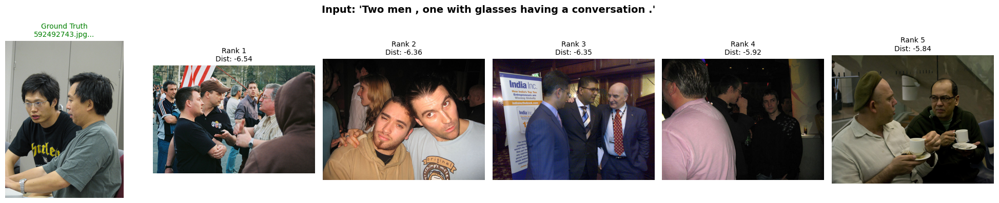

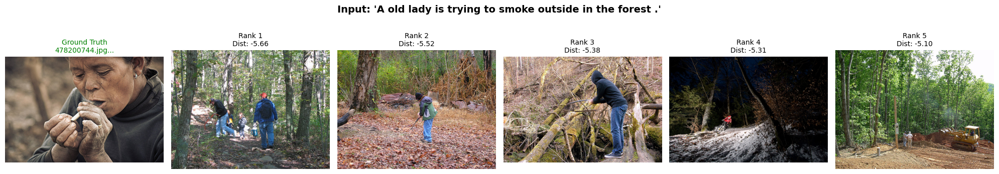

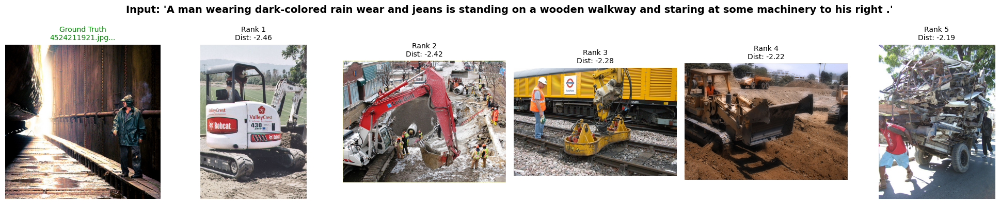

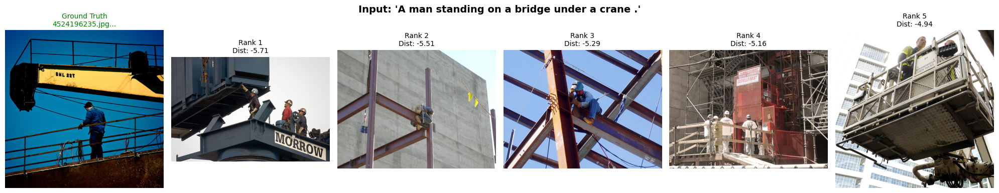

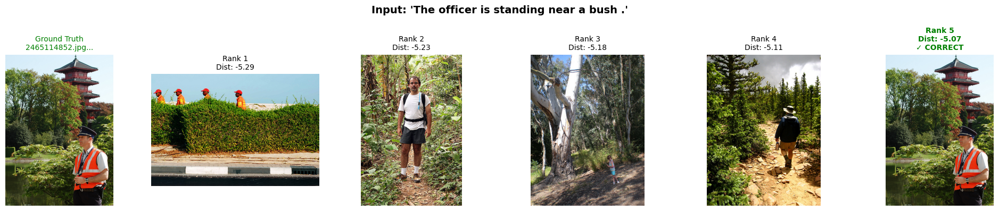

In [31]:
# --- COSTRUZIONE SPLIT VAL (ok) ---
label_all = train_data['captions/label']
cap_mask  = ~TRAIN_SPLIT

if hasattr(label_all, "sum"):
    col_sums = np.asarray(label_all[cap_mask].sum(axis=0)).ravel()
else:
    col_sums = label_all[cap_mask].sum(axis=0)
img_VAL_SPLIT = col_sums > 0

val_caption_text = train_data['captions/text'][cap_mask]
val_text_embd    = X_val                                # torch [N_val_cap, d_in]
val_img_file     = train_data['images/names'][img_VAL_SPLIT]

# ⬅️ QUI: usa TENSORI per le immagini (CPU, float32)
val_img_embd     = torch.from_numpy(
    train_data['images/embeddings'][img_VAL_SPLIT]
).float()                                              # torch [N_val_img, d_out]

# GT index per caption (denso o sparse)
lbl_val = label_all[cap_mask][:, img_VAL_SPLIT]
if hasattr(lbl_val, "tocoo"):
    coo = lbl_val.tocoo()
    rows, cols = coo.row, coo.col
    order = np.argsort(rows)
    rows, cols = rows[order], cols[order]
    _, first_pos = np.unique(rows, return_index=True)
    gt_index_per_cap = cols[first_pos]
else:
    gt_index_per_cap = np.argmax(lbl_val, axis=1).ravel()

# --- ISPEZIONE 5 ESEMPI ---
from challenge.src.eval import visualize_retrieval  # o 'from src.eval import visualize_retrieval'
model.eval()
for _ in range(5):
    idx = np.random.randint(0, len(val_caption_text))
    caption_text = val_caption_text[idx]
    caption_embd = val_text_embd[idx:idx+1].to(DEVICE)  # [1, d_in]

    with torch.no_grad():
        # ⬅️ QUI: RESTA TENSORE (CPU), NON .numpy()
        pred_embds = model(caption_embd).detach().cpu()  # [1, d_out], torch

    gt_index = int(gt_index_per_cap[idx])

    visualize_retrieval(
        pred_embds,        # torch [1, d_out]
        gt_index,          # int
        val_img_file,      # list/array di nomi file
        caption_text,      # str
        val_img_embd,      # torch [N_val_img, d_out]
        k=5
    )
